# What drives the price of a car?

![](images/kurt.jpeg)

**OVERVIEW**

In this application, you will explore a dataset from kaggle that contains information on 3 million used cars.  Your goal is to understand what factors make a car more or less expensive.  As a result of your analysis, you should provide clear recommendations to your client -- a used car dealership -- as to what consumers value in a used car.

### CRISP-DM Framework

<center>
    <img src = images/crisp.png width = 50%/>
</center>


To frame the task, throughout our practical applications we will refer back to a standard process in industry for data projects called CRISP-DM.  This process provides a framework for working through a data problem.  Your first step in this application will be to read through a brief overview of CRISP-DM [here](https://mo-pcco.s3.us-east-1.amazonaws.com/BH-PCMLAI/module_11/readings_starter.zip).  After reading the overview, answer the questions below.

### Business Understanding

From a business perspective, we are tasked with identifying key drivers for used car prices.  In the CRISP-DM overview, we are asked to convert this business framing to a data problem definition.  Using a few sentences, reframe the task as a data task with the appropriate technical vocabulary. 

### Data Understanding

After considering the business understanding, we want to get familiar with our data.  Write down some steps that you would take to get to know the dataset and identify any quality issues within.  Take time to get to know the dataset and explore what information it contains and how this could be used to inform your business understanding.

In [1]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

In [2]:
dfCars = pd.read_csv('data/vehicles.csv')
print(dfCars.shape)
dfCars.head()

(426880, 18)


,id,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,VIN,drive,size,type,paint_color,state
0,7222695916,prescott,6000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,az
1,7218891961,fayetteville,11900,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ar
2,7221797935,florida keys,21000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,fl
3,7222270760,worcester / central MA,1500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ma
4,7210384030,greensboro,4900,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,nc


In [4]:
dfCars.isnull().sum()

id                   0
region               0
price                0
year              1205
manufacturer     17646
model             5277
condition       174104
cylinders       177678
fuel              3013
odometer          4400
title_status      8242
transmission      2556
VIN             161042
drive           130567
size            306361
type             92858
paint_color     130203
state                0
dtype: int64

### Data Preparation

After our initial exploration and fine tuning of the business understanding, it is time to construct our final dataset prior to modeling.  Here, we want to make sure to handle any integrity issues and cleaning, the engineering of new features, any transformations that we believe should happen (scaling, logarithms, normalization, etc.), and general preparation for modeling with `sklearn`. 

### Dropping non useful columns such as id and VIN

In [5]:
dfCars = dfCars.drop(columns=['id', 'VIN'], axis=1)

### Looking at car prices, some of the prices are clearly outliers running into billions

#### Plots have increased the size of file to 180 mb, so using images and commenting out code.

In [6]:
#fig = px.box(dfCars['price']).update_layout(title = 'Box Plot of Original Car Prices')
#fig.write_image('images/Original_CarPrices_BoxPlot.png')
#fig.show()

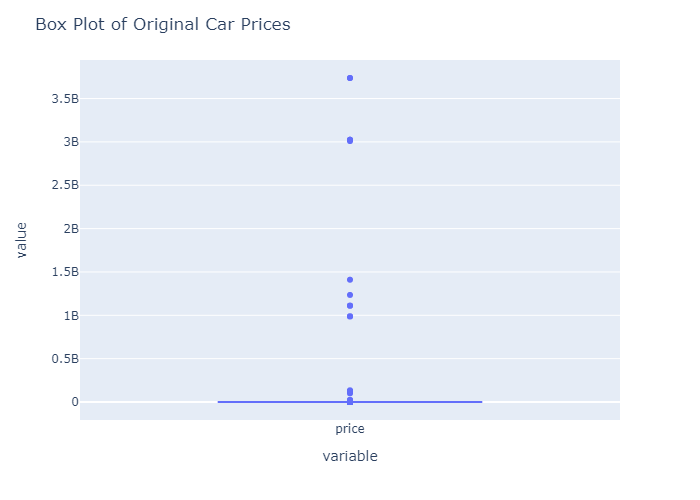

### Looking at 1.5 * IQR rule to apply to price outliers

In [7]:
lowerQuartile = dfCars['price'].quantile(0.25)
UpperQuartile = dfCars['price'].quantile(0.75)
IQR = UpperQuartile - lowerQuartile
UL = UpperQuartile + 1.5 * IQR
LL = lowerQuartile - 1.5 * IQR 
print(f'LowerLimit : {LL:.2f}, LowerQuartile: {lowerQuartile:.2f}, UpperQuartile: {UpperQuartile:.2f}, UpperLimit : {UL:.2f}')

LowerLimit : -24978.62, LowerQuartile: 5900.00, UpperQuartile: 26485.75, UpperLimit : 57364.38


###  Applying this rule will distort 8177 prices. So ignoring it for now.

In [8]:
dfCars[dfCars['price'] > UL].shape

(8177, 16)

#### Dropping those cars with prices over 500,000 USD as there are only 68 of them

In [9]:
dfCars.loc[dfCars['price'] > 500_000, 'price'].count()

68

In [10]:
dfCars = dfCars.loc[dfCars['price'] <= 500_000]
dfCars.shape

(426812, 16)

### Dropping cars with prices lower than 50 dollars or those with odometer less than 500 (an assumption that cars with odometer reading over 500 are second hand cars), will lose about 42,000 data points

In [11]:
dfCars.loc[dfCars['price'].lt(50) | dfCars['odometer'].lt(500)].shape

(42384, 16)

In [12]:
dfCars =dfCars.loc[~(dfCars['price'].lt(50) | dfCars['odometer'].lt(500))]
dfCars.shape

(384428, 16)

In [14]:
#fig = px.box(dfCars['price']).update_layout(title = 'Box plot of Cleaned Prices')
#fig.write_image('images/Cleaned_CarPrices_BoxPlot.png')
#fig.show()

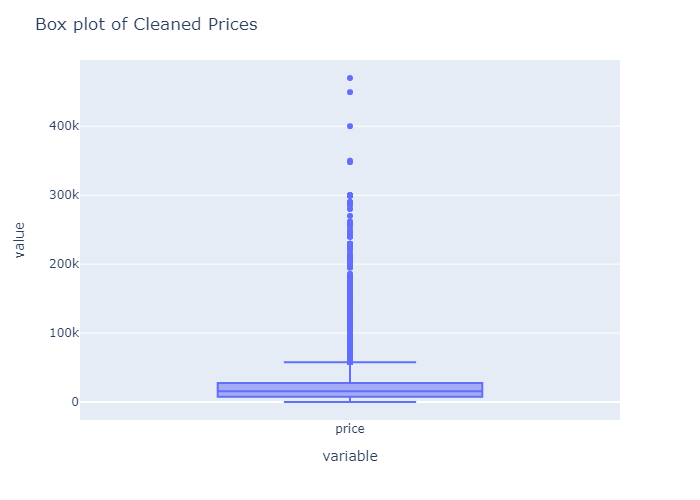

### Log of the price looks more normal than just the price. So for any predictions, one should use log of the price

In [64]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

fig = make_subplots(rows=1, cols=2, subplot_titles=("Price", "Log of Price"))
#plt.figure(figsize=(15,10))
fig.add_trace(
    go.Histogram(x=dfCars['price']), row=1, col=1
)

fig.add_trace(
    go.Histogram(x=np.log(dfCars['price'])), row=1, col=2
)
fig.update_layout(showlegend=False)
fig.write_image('images/price_and_log_of_price.png')
fig.show()

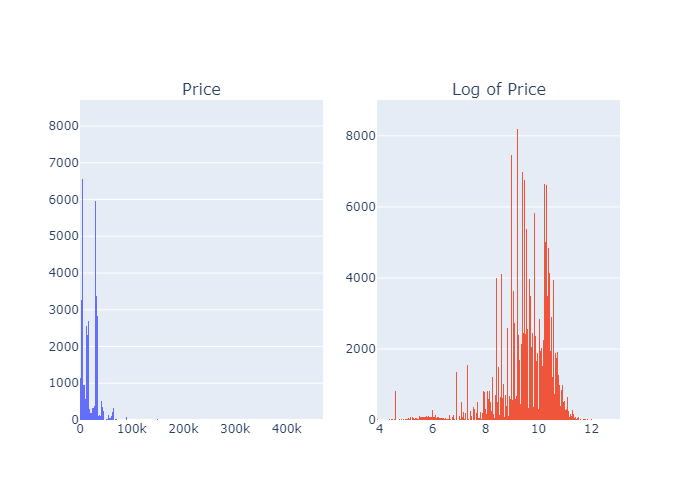

#### Removing rows where odometer reading is greater than 300,000 as this it only removes 2898 rows

In [18]:
dfCars = dfCars[dfCars['odometer'] < 300_000]
dfCars.shape

(379148, 16)

### Dropping those cars with missing year and odometer readings removes 945 rows

In [19]:
dfCars.loc[(dfCars['year'].isnull() | dfCars['odometer'].isnull())].shape

(945, 16)

In [20]:
dfCars = dfCars.loc[~(dfCars['year'].isnull() | dfCars['odometer'].isnull())]
dfCars.shape

(378203, 16)

### Handling Missing Categorical Values

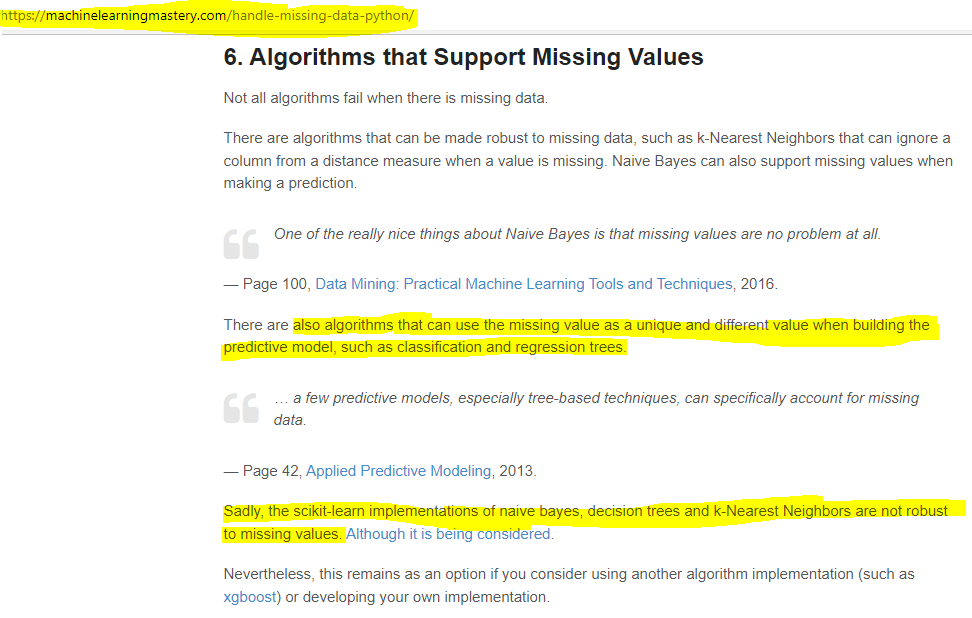

### Imputing/Filling missing categorical variable data using IterativeImputer
### In sklearn, all columns should be numeric to use the IterativeImputer. So first converting the Categorical to Numerical using category encoder

### Converting Categorical columns into numeric using TargetEncoder

##### https://contrib.scikit-learn.org/category_encoders/index.html

In [21]:
dfCars.head()

,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,drive,size,type,paint_color,state
27,auburn,33590,2014.0,gmc,sierra 1500 crew cab slt,good,8 cylinders,gas,57923.0,clean,other,NaN,NaN,pickup,white,al
28,auburn,22590,2010.0,chevrolet,silverado 1500,good,8 cylinders,gas,71229.0,clean,other,NaN,NaN,pickup,blue,al
29,auburn,39590,2020.0,chevrolet,silverado 1500 crew,good,8 cylinders,gas,19160.0,clean,other,NaN,NaN,pickup,red,al
30,auburn,30990,2017.0,toyota,tundra double cab sr,good,8 cylinders,gas,41124.0,clean,other,NaN,NaN,pickup,red,al
31,auburn,15000,2013.0,ford,f-150 xlt,excellent,6 cylinders,gas,128000.0,clean,automatic,rwd,full-size,truck,black,al


In [23]:
import category_encoders as ce
encoder = ce.TargetEncoder()

In [24]:
y = np.log(dfCars['price'])
dfCars_encoded = encoder.fit_transform(dfCars.drop('price', axis=1), y)
dfCars_encoded.head()

,region,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,drive,size,type,paint_color,state
27,10.065362,2014.0,9.813494,10.465071,9.661717,9.751215,9.364114,57923.0,9.492877,10.166942,9.421379,9.577115,10.078642,9.739198,9.661076
28,10.065362,2010.0,9.524183,9.783992,9.661717,9.751215,9.364114,71229.0,9.492877,10.166942,9.421379,9.577115,10.078642,9.402291,9.661076
29,10.065362,2020.0,9.524183,10.411139,9.661717,9.751215,9.364114,19160.0,9.492877,10.166942,9.421379,9.577115,10.078642,9.541083,9.661076
30,10.065362,2017.0,9.402583,10.451709,9.661717,9.751215,9.364114,41124.0,9.492877,10.166942,9.421379,9.577115,10.078642,9.541083,9.661076
31,10.065362,2013.0,9.597089,9.535120,9.340639,9.434045,9.364114,128000.0,9.492877,9.349481,9.643816,9.299744,9.885239,9.700898,9.661076


### Observation: The encoding function is creating encoded values in the range of the target, i.e. if y is large, large values are being created and if y is small where log values are used, the encoded values are small.

In [25]:
dfCars_encoded.isnull().sum()

region          0
year            0
manufacturer    0
model           0
condition       0
cylinders       0
fuel            0
odometer        0
title_status    0
transmission    0
drive           0
size            0
type            0
paint_color     0
state           0
dtype: int64

In [54]:
dfCars_encoded.shape

(378203, 15)

In [26]:
print(dfCars['fuel'].value_counts())
dfCars_encoded['fuel'].value_counts()

gas         317918
other        27584
diesel       24309
hybrid        4761
electric      1562
Name: fuel, dtype: int64


9.364114     317918
10.034688     27584
10.182352     24309
9.370156       4761
9.713339       2069
9.884950       1562
Name: fuel, dtype: int64

In [27]:
dfCars['fuel'].isnull().sum()

2069

### It can be seen that the Empty Rows in the Fuel column have all been categorized into one single category of 9.713339

In [28]:
dfCars_encoded['model'].value_counts()

9.469751    13695
9.766432     6844
9.783992     4308
9.258200     4106
9.758289     3708
            ...  
5.976459        2
9.868056        2
6.673961        2
9.518265        2
9.049267        2
Name: model, Length: 11448, dtype: int64

In [29]:
dfCars['model'].value_counts()

f-150                      6844
silverado 1500             4308
1500                       3708
camry                      2724
silverado                  2671
                           ... 
tl 3.2 4dr sedan              1
1500 quad cab hemi            1
isetta                        1
ln 8000                       1
Paige Glenbrook Touring       1
Name: model, Length: 26627, dtype: int64

In [30]:
dfCars['model'].isnull().sum()

4106

#### It can be seen that the TargetEncoder has done something different on the mising values of model column.

### Plotting the correlation matrix of the encoded data

In [31]:
dfCars_encoded_with_price = pd.concat([dfCars_encoded, y], axis=1)
dfCars_encoded_with_price.head()

,region,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,drive,size,type,paint_color,state,price
27,10.065362,2014.0,9.813494,10.465071,9.661717,9.751215,9.364114,57923.0,9.492877,10.166942,9.421379,9.577115,10.078642,9.739198,9.661076,10.421984
28,10.065362,2010.0,9.524183,9.783992,9.661717,9.751215,9.364114,71229.0,9.492877,10.166942,9.421379,9.577115,10.078642,9.402291,9.661076,10.025263
29,10.065362,2020.0,9.524183,10.411139,9.661717,9.751215,9.364114,19160.0,9.492877,10.166942,9.421379,9.577115,10.078642,9.541083,9.661076,10.586332
30,10.065362,2017.0,9.402583,10.451709,9.661717,9.751215,9.364114,41124.0,9.492877,10.166942,9.421379,9.577115,10.078642,9.541083,9.661076,10.341420
31,10.065362,2013.0,9.597089,9.535120,9.340639,9.434045,9.364114,128000.0,9.492877,9.349481,9.643816,9.299744,9.885239,9.700898,9.661076,9.615805


### It's interesting to note that the correlation between different categorical labels and the price do tell a story about how each variable impacts the price. The model of a car has the highest positive correlation and odometer the highest negative correlation to the price of a car.

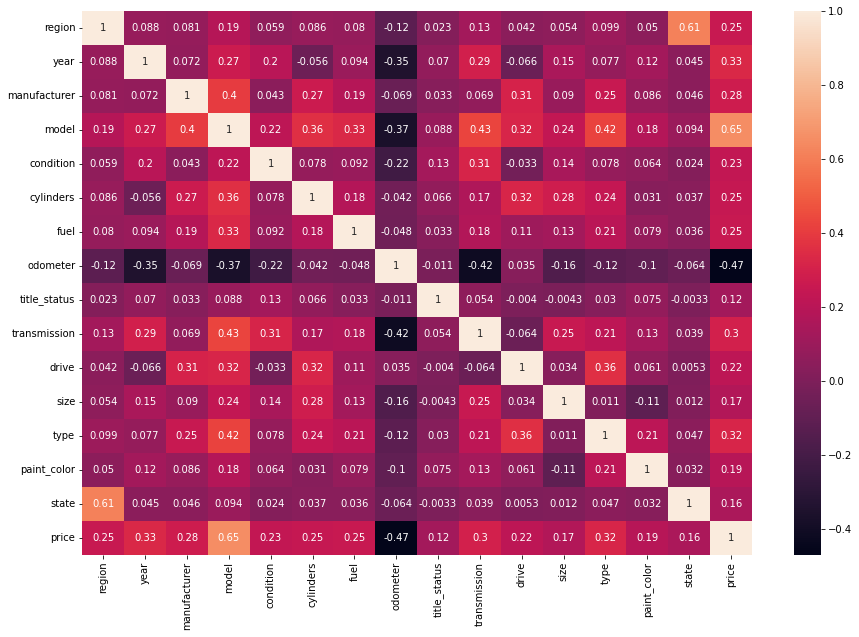

In [32]:
fig = plt.figure(figsize = (15,10))
sns.heatmap(dfCars_encoded_with_price.corr(), annot=True)
plt.savefig('images/Heatmap.png')
plt.show()

##### https://scikit-learn.org/stable/modules/generated/sklearn.impute.IterativeImputer.html#sklearn.impute.IterativeImputer
#### https://machinelearningmastery.com/iterative-imputation-for-missing-values-in-machine-learning/

In [33]:
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.linear_model import BayesianRidge, LogisticRegression, TweedieRegressor, SGDRegressor 

In [255]:
#imputer = IterativeImputer(
#    estimator = BayesianRidge(),
#    n_nearest_features = None,
#    imputation_order = 'ascending'
#)
#imputer = IterativeImputer(estimator = SGDRegressor(), initial_strategy = 'most_frequent', 
#                           n_nearest_features = None, random_state=0,
#                          verbose=2)

#X = dfCars.drop(columns = ['price'], axis=1)
#y = dfCars['price']


#imputer.fit(X)
#dfCars_imputed = imputer.transform(X)

#dfCars_imputed.head()


### Ignoring the imputation as all the rows are now filled.

### Modeling

With your (almost?) final dataset in hand, it is now time to build some models.  Here, you should build a number of different regression models with the price as the target.  In building your models, you should explore different parameters and be sure to cross-validate your findings.

In [34]:
dfCars_encoded.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 378203 entries, 27 to 426879
Data columns (total 15 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   region        378203 non-null  float64
 1   year          378203 non-null  float64
 2   manufacturer  378203 non-null  float64
 3   model         378203 non-null  float64
 4   condition     378203 non-null  float64
 5   cylinders     378203 non-null  float64
 6   fuel          378203 non-null  float64
 7   odometer      378203 non-null  float64
 8   title_status  378203 non-null  float64
 9   transmission  378203 non-null  float64
 10  drive         378203 non-null  float64
 11  size          378203 non-null  float64
 12  type          378203 non-null  float64
 13  paint_color   378203 non-null  float64
 14  state         378203 non-null  float64
dtypes: float64(15)
memory usage: 54.2 MB


In [35]:
from sklearn.linear_model import LinearRegression, Ridge, Lasso
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.compose import TransformedTargetRegressor
from sklearn.feature_selection import SequentialFeatureSelector


In [36]:
X = dfCars_encoded
y = dfCars['price']
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.3, random_state=42)

In [37]:
X_train.head()

,region,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,drive,size,type,paint_color,state
50442,9.588618,2019.0,9.245635,9.631515,9.466127,8.997126,9.364114,26102.0,9.492877,9.349481,9.712016,9.577115,9.442742,9.739198,9.460048
280742,9.559879,2014.0,9.597089,9.110964,9.466127,9.595809,9.364114,140000.0,9.492877,9.349481,9.421379,9.577115,9.173006,9.278549,9.472171
327222,8.630823,2012.0,9.524183,9.634820,9.466127,9.595809,9.364114,156909.0,9.492877,9.349481,9.712016,9.577115,10.078642,9.739198,9.179520
249763,9.404172,2002.0,9.597089,9.778816,7.928282,9.751215,10.182352,159000.0,9.492877,9.349481,9.712016,9.299744,9.173006,9.051256,9.300938
184542,9.723739,1988.0,9.597089,9.258200,9.340639,8.997126,9.364114,138192.0,9.492877,9.157563,9.643816,9.299744,9.679206,9.302920,9.474745


In [38]:
r = Ridge()
ttr = TransformedTargetRegressor(regressor = r, func = np.log, inverse_func = np.exp )

In [39]:
model_pipe = Pipeline([
    ('ss', StandardScaler()),
    ('reg', ttr)
])

In [40]:
model_pipe.get_params()

{'memory': None,
 'steps': [('ss', StandardScaler()),
  ('reg',
   TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                              regressor=Ridge()))],
 'verbose': False,
 'ss': StandardScaler(),
 'reg': TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                            regressor=Ridge()),
 'ss__copy': True,
 'ss__with_mean': True,
 'ss__with_std': True,
 'reg__check_inverse': True,
 'reg__func': <ufunc 'log'>,
 'reg__inverse_func': <ufunc 'exp'>,
 'reg__regressor__alpha': 1.0,
 'reg__regressor__copy_X': True,
 'reg__regressor__fit_intercept': True,
 'reg__regressor__max_iter': None,
 'reg__regressor__normalize': 'deprecated',
 'reg__regressor__positive': False,
 'reg__regressor__random_state': None,
 'reg__regressor__solver': 'auto',
 'reg__regressor__tol': 0.001,
 'reg__regressor': Ridge(),
 'reg__transformer': None}

In [41]:
model_params = {'reg__regressor': [Ridge(), Lasso()],
               'reg__regressor__alpha': [0.001, 0.01, 0.1, 1, 10, 100]
               }

In [42]:
grid = GridSearchCV(
                estimator = model_pipe,
                param_grid = model_params
)

In [43]:
grid.get_params()

{'cv': None,
 'error_score': nan,
 'estimator__memory': None,
 'estimator__steps': [('ss', StandardScaler()),
  ('reg',
   TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                              regressor=Ridge()))],
 'estimator__verbose': False,
 'estimator__ss': StandardScaler(),
 'estimator__reg': TransformedTargetRegressor(func=<ufunc 'log'>, inverse_func=<ufunc 'exp'>,
                            regressor=Ridge()),
 'estimator__ss__copy': True,
 'estimator__ss__with_mean': True,
 'estimator__ss__with_std': True,
 'estimator__reg__check_inverse': True,
 'estimator__reg__func': <ufunc 'log'>,
 'estimator__reg__inverse_func': <ufunc 'exp'>,
 'estimator__reg__regressor__alpha': 1.0,
 'estimator__reg__regressor__copy_X': True,
 'estimator__reg__regressor__fit_intercept': True,
 'estimator__reg__regressor__max_iter': None,
 'estimator__reg__regressor__normalize': 'deprecated',
 'estimator__reg__regressor__positive': False,
 'estimator__reg__regressor__r

In [44]:
grid.fit(X_train, y_train)

GridSearchCV(estimator=Pipeline(steps=[('ss', StandardScaler()),
                                       ('reg',
                                        TransformedTargetRegressor(func=<ufunc 'log'>,
                                                                   inverse_func=<ufunc 'exp'>,
                                                                   regressor=Ridge()))]),
             param_grid={'reg__regressor': [Ridge(), Lasso(alpha=0.01)],
                         'reg__regressor__alpha': [0.001, 0.01, 0.1, 1, 10,
                                                   100]})

In [45]:
grid.best_estimator_

Pipeline(steps=[('ss', StandardScaler()),
                ('reg',
                 TransformedTargetRegressor(func=<ufunc 'log'>,
                                            inverse_func=<ufunc 'exp'>,
                                            regressor=Lasso(alpha=0.01)))])

### Evaluation

With some modeling accomplished, we aim to reflect on what we identify as a high quality model and what we are able to learn from this.  We should review our business objective and explore how well we can provide meaningful insight on drivers of used car prices.  Your goal now is to distill your findings and determine whether the earlier phases need revisitation and adjustment or if you have information of value to bring back to your client.

### The best model estimated is Lasso Regressor with an alpha of 0.01

In [46]:
grid.best_estimator_.score(X_test,y_test)

0.5968432038558869

In [47]:
grid.cv_results_

{'mean_fit_time': array([0.12765107, 0.12370434, 0.12188215, 0.12283101, 0.11495333,
        0.1172636 , 0.21549482, 0.2106801 , 0.16114812, 0.12939796,
        0.1362154 , 0.1413486 ]),
 'std_fit_time': array([0.0087557 , 0.01423049, 0.0181335 , 0.01222021, 0.00925405,
        0.01538307, 0.00940253, 0.00917516, 0.0043121 , 0.01036797,
        0.01072997, 0.00921939]),
 'mean_score_time': array([0.00874205, 0.00912428, 0.00667124, 0.00479627, 0.00719185,
        0.01066542, 0.00687518, 0.0113018 , 0.00452194, 0.01223307,
        0.00165973, 0.01145015]),
 'std_score_time': array([0.00476151, 0.00867374, 0.00819703, 0.00690515, 0.00697035,
        0.00055981, 0.008021  , 0.00640751, 0.00553928, 0.00235801,
        0.00222343, 0.0013642 ]),
 'param_reg__regressor': masked_array(data=[Ridge(), Ridge(), Ridge(), Ridge(), Ridge(), Ridge(),
                    Lasso(alpha=0.01), Lasso(alpha=0.01),
                    Lasso(alpha=0.01), Lasso(alpha=0.01),
                    Lasso(alpha=0.01

In [48]:
grid.best_score_

0.5941104590868731

In [49]:
from sklearn.inspection import permutation_importance

In [50]:
r = permutation_importance(grid.best_estimator_, X_test, y_test, n_repeats = 10, random_state = 123)
r.importances_mean

array([ 0.00113122,  0.02345586,  0.00139506,  0.54629912, -0.00378914,
        0.00535933,  0.00906477,  0.17302135,  0.00370585,  0.07472552,
        0.00882812,  0.        ,  0.0021524 , -0.00346134, -0.00187398])

In [51]:
pd.DataFrame({"Variable":X.columns, "Score":r.importances_mean}).sort_values(by = "Score", ascending = False)

,Variable,Score
3,model,0.546299
7,odometer,0.173021
9,transmission,0.074726
1,year,0.023456
6,fuel,0.009065
10,drive,0.008828
5,cylinders,0.005359
8,title_status,0.003706
12,type,0.002152
2,manufacturer,0.001395


### Model of the car has the highest importance in predicting the price of car followed by odometer, transmission and year of manufacturing and the same was also reflected in the correlation matrix!!!

### Deployment

Now that we've settled on our models and findings, it is time to deliver the information to the client.  You should organize your work as a basic report that details your primary findings.  Keep in mind that your audience is a group of used car dealers interested in fine tuning their inventory.

In [52]:
dfCars['model'].value_counts()[:15]

f-150             6844
silverado 1500    4308
1500              3708
camry             2724
silverado         2671
accord            2635
wrangler          2610
civic             2549
escape            2450
altima            2380
2500              2361
tacoma            2300
explorer          2175
grand cherokee    2159
corolla           1946
Name: model, dtype: int64

### Top selling models are f-150, silverado and camry. Maintaining stock in these models is recommended as they are the best selling secondhand car models 

In [53]:
#TopModels = dfCars['model'].value_counts()[:15].index
#dfCars_top_models = dfCars[dfCars['model'].isin(TopModels)]
#fig = px.box(dfCars_top_models, x='model', y='price', 
#       category_orders = {'model' : list(dfCars['model'].value_counts().index[:15])})
#fig.update_layout(title = 'Top Selling Models with their price distribution')
#fig.write_image('images/Top_Selling_Models.png')
#fig.show()

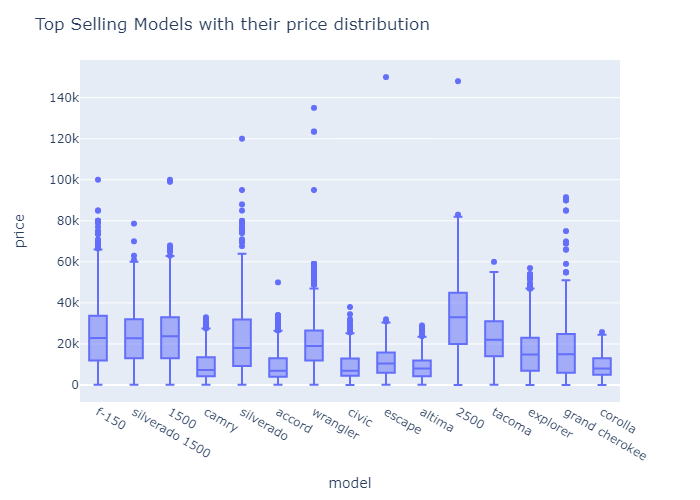

### Second hand car drivers also look for cars with lower odometer readings and is the second highest criteria that a driver uses to decide to buy a second hand car

### The top selling brands are Ford (17%) , Chevrolet (13%) and Toyota (8%) with median prices of 17,500 ; 16,500 and 14,000 USD respectively

In [54]:
#fig = px.box(dfCars, x='manufacturer', y='price', 
#       category_orders = {'manufacturer' : list(dfCars['manufacturer'].value_counts().index)})
#fig.update_layout(title = 'Top Selling Brands')
#fig.write_image('images/Top_Selling_Brands.png')
#fig.show()

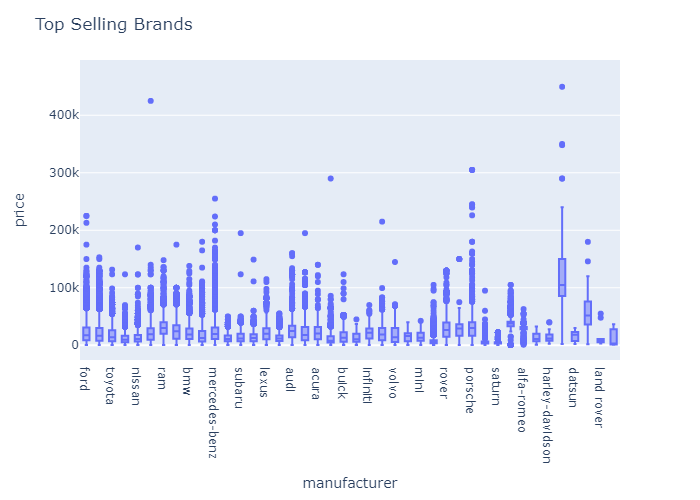

#### Converting the Cylinder column to Numeric 

In [55]:
dfCars['cylinders'] = [int(dfCars.loc[x, 'cylinders'][:2].strip())
                 if ((pd.notna(dfCars.loc[x, 'cylinders'])) & (dfCars.loc[x, 'cylinders'] != 'other'))
                else dfCars.loc[x, 'cylinders'] for x in dfCars.index]

### For sales where a cylinder was quoted, 6 cylinder was the most popular with a median price of 15,400 USD followed by 4 cylinder cars with a median price of 9,000 USD and closely followed by 8 cylinder cars with a median price of 21,000 USD.

In [58]:
dfCarsWithCylinders = dfCars.loc[dfCars['cylinders'] != 'No cylinders']
#fig = px.bar(dfCarsWithCylinders['cylinders'].value_counts(normalize=True), orientation='h',
#            text = dfCarsWithCylinders['cylinders'].value_counts())
#fig.update_layout(title = 'Sales by No of Cylinders',
#                 yaxis_title = 'No of Cylinders',
#                 xaxis_title='Percentage of Sales')           
#fig.write_image('images/BarChartSalesByCylinders.png')
#fig.show()

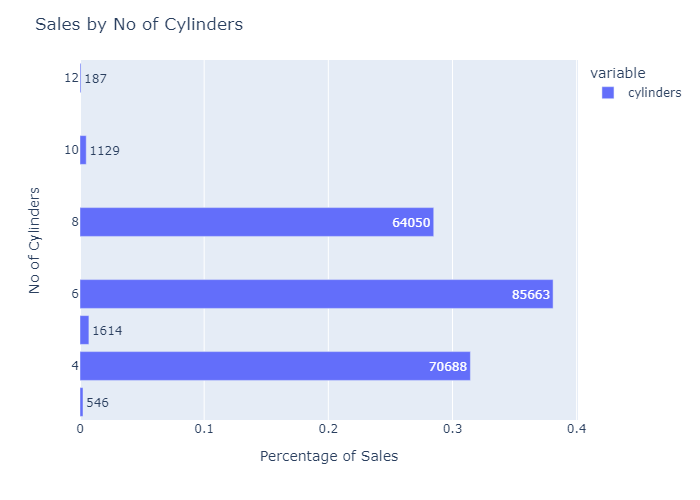

In [59]:
#fig = px.box(dfCars, x='cylinders', y ='price')\
#        .update_layout(title = 'Distribution of Sale Prices by No of Cylinders')
#fig.write_image('images/Carprice_by_no_of_cylinders.png')
#fig.show()

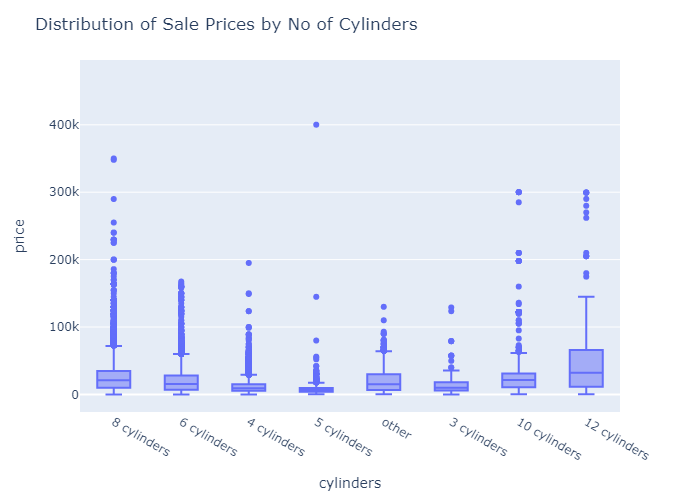

### Four Wheel drive cars are the most popular with a median price of 20,500 USD

In [60]:
#fig = px.box(dfCars, x='drive', y='price',  category_orders = {'drive' : list(dfCars['drive'].value_counts().index)})\
#        .update_layout(title = 'Distribution of Sale Prices by drive type')
#fig.write_image('images/Carprice_by_drive_type.png')
#fig.show()

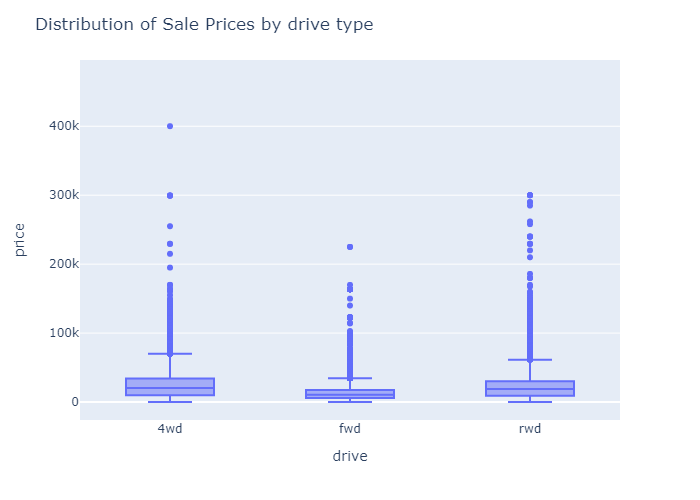

### Cars with condition marked as good were the most popluar with salvage being the least popular for obvious reasons

In [61]:
#fig = px.box(dfCars, x = 'condition', y= 'price',  
#       category_orders = {'condition' : list(dfCars['condition'].value_counts().index)})\
#        .update_layout(title = 'Distribution of Sale prices by Condition of Car')
#fig.write_image('images/CarPrice_by_condition_of_car.png')
#fig.show()

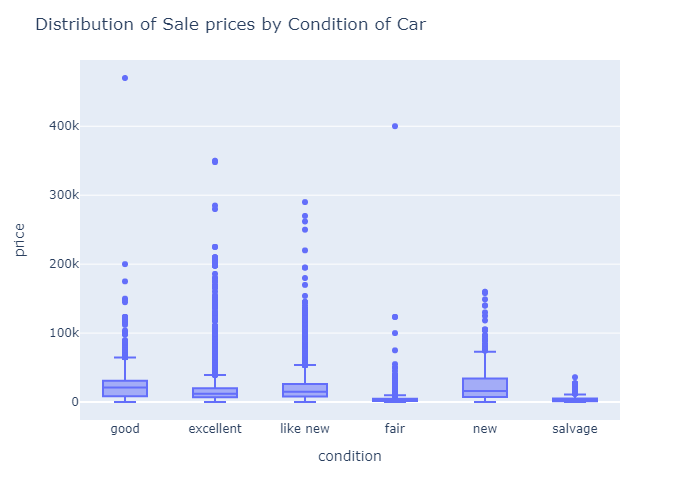

### Pickup, truck and coupe seem to be the best selling car types.

In [62]:
#fig = px.box(dfCars, x = 'type', y= 'price', 
#      category_orders = {'type' : list(dfCars['type'].value_counts().index)})\
#    .update_xaxes(categoryorder = 'mean descending')\
#    .update_layout(title = 'Distribution of Sale prices by Type of Car')
#fig.write_image('images/CarPrice_by_type_of_car.png')
#fig.show()

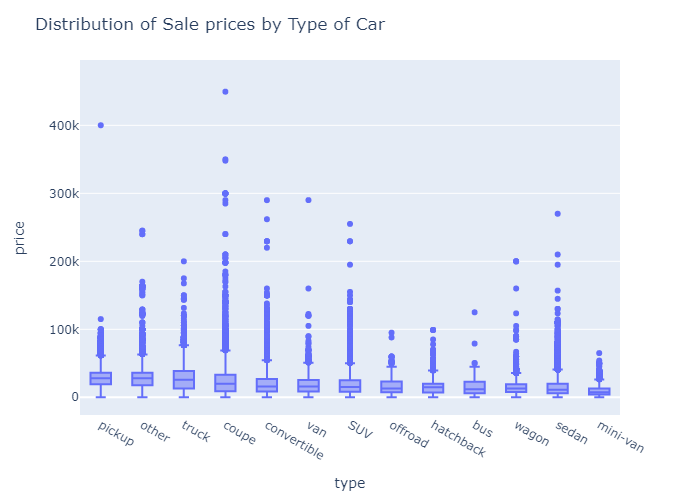

### Automatic cars are the most popular second hand car types

In [63]:
#fig = px.box(dfCars, x = 'transmission', y= 'price', 
#      category_orders = {'transmission' : list(dfCars['transmission'].value_counts().index)})\
#        .update_layout(title = 'Distribution of Sale prices by transmission')
#fig.write_image('images/SalesPrice_by_tranmission.png')
#fig.show()

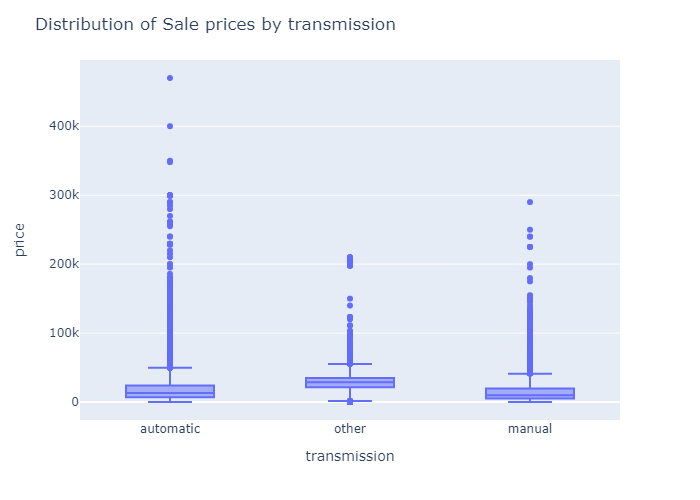